# SatLomas: Modelo U-Net + Sentinel-2

In [3]:
from unetseg.train import TrainConfig, train
from unetseg.predict import PredictConfig, predict
from unetseg.evaluate import plot_data_generator
import os

In [4]:
DATA_DIR = os.path.join(os.path.expanduser("~"), "data", "lomas", "s2")

## Dataset Preparation

For training:

In [ ]:
!satproc_extract_chips \
    -v --size 160 --step-size 80 \
    -o $DATA_DIR/train/160_80/ \
    --bands 1 2 3 \
    --labels $DATA_DIR/train/20190411/poly.shp \
    --classes L C \
    --aoi $DATA_DIR/train/20190411/poly.shp \
    $DATA_DIR/train/20190411/TCI_2019.tif

In [ ]:
!satproc_extract_chips \
    -v --size 160 --step-size 80 \
    -o $DATA_DIR/train/160_80/ \
    --bands 1 2 3 \
    --labels $DATA_DIR/train/20200420/poly.shp \
    --classes L C \
    --aoi $DATA_DIR/train/20200420/poly.shp \
    $DATA_DIR/train/20200420/TCI_2020.tif

In [ ]:
!satproc_extract_chips \
    -v --size 160 --step-size 80 \
    -o $DATA_DIR/train/160_80/ \
    --bands 1 2 3 \
    --labels $DATA_DIR/train/2017/poly.shp \
    --classes L C \
    --aoi $DATA_DIR/train/2017/poly.shp \
    $DATA_DIR/train/2017/TCI_2017.tif

For predicting on train area:

In [ ]:
!satproc_extract_chips \
    -v --size 160 --step-size 160 \
    --bands 1 2 3 \
    -o $DATA_DIR/train/160_160_20190411/ \
    $DATA_DIR/train/20190411/TCI.tif

In [ ]:
!satproc_extract_chips \
    -v --size 160 --step-size 160 \
    --bands 1 2 3 \
    -o $DATA_DIR/train/160_160_20200420/ \
    $DATA_DIR/train/20200420/TCI.tif    

In [20]:
!tree -d $DATA_DIR

/home/ro/data/lomas/s2
├── predict
│   ├── 160_160_20190411
│   │   ├── images
│   │   └── results
│   │       └── v10
│   └── 160_160_20200420
│       ├── images
│       └── results
│           └── v10
├── train
│   ├── 2017
│   ├── 20190411
│   ├── 20200420
│   └── old
│       ├── 120_120
│       │   ├── images
│       │   └── masks
│       ├── 120_120_scaled
│       │   ├── images
│       │   ├── masks
│       │   └── results
│       ├── 120_60
│       │   ├── images
│       │   └── masks
│       ├── 120_60_scaled
│       │   ├── images
│       │   └── masks
│       ├── 160_80
│       │   ├── images
│       │   └── masks
│       └── 160_80_scaled
│           ├── images
│           └── masks
└── weights

34 directories


## Train

In [25]:
config = TrainConfig(width=160,
                     height=160,
                     n_channels=3,
                     n_classes=2,
                     apply_image_augmentation=True,
                     seed=42,
                     epochs=30,
                     batch_size=64,
                     steps_per_epoch=300,
                     early_stopping_patience=5,
                     validation_split=0.1,
                     images_path=os.path.join(DATA_DIR, 'train', '160_80'),
                     model_path=os.path.join(DATA_DIR, 'weights', 'lomas_sen2_v9.h5'))

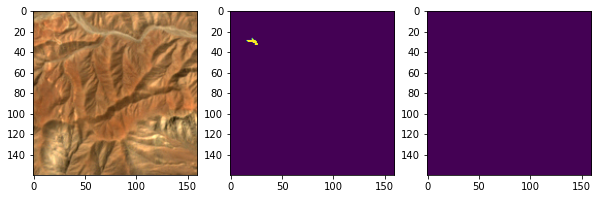

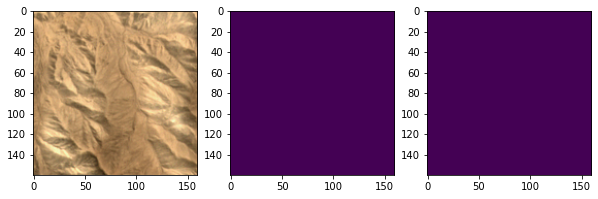

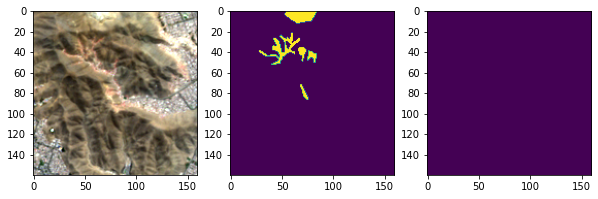

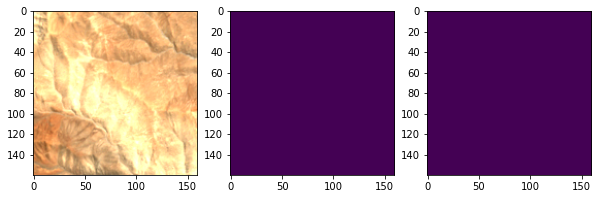

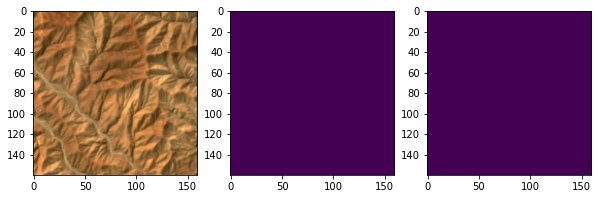

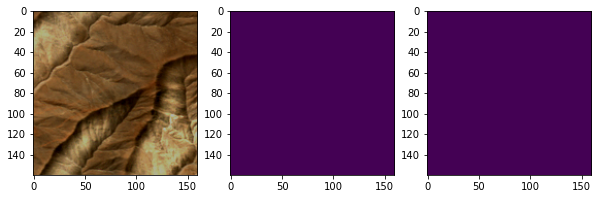

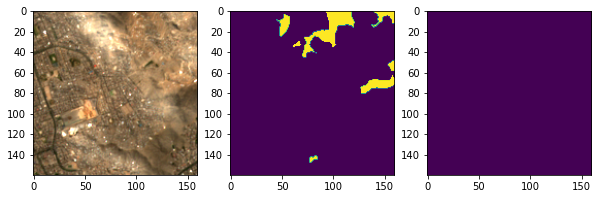

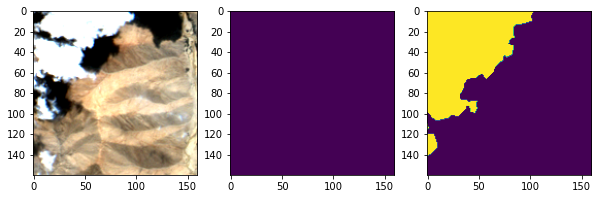

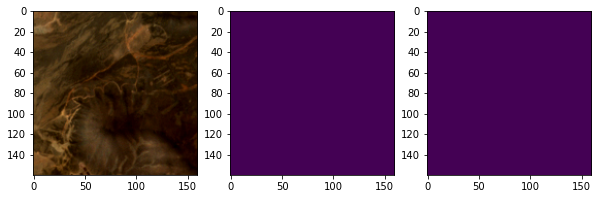

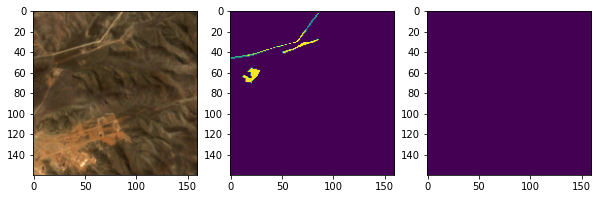

In [28]:
plot_data_generator(train_config=config, num_samples=10, fig_size=(10,6))

In [29]:
train(config)

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 160, 160, 3)  0                                            
__________________________________________________________________________________________________
conv2d_47 (Conv2D)              (None, 160, 160, 32) 896         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_48 (Conv2D)              (None, 160, 160, 32) 9248        conv2d_47[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_11 (MaxPooling2D) (None, 80, 80, 32)   0           conv2d_48[0][0]                  
____________________________________________________________________________________________

Epoch 1/30
300/300 [==============================] - 129s 431ms/step - loss: 0.1495 - val_loss: 0.7470

Epoch 00001: val_loss improved from inf to 0.74704, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v9.h5
Epoch 2/30
300/300 [==============================] - 117s 390ms/step - loss: 0.0905 - val_loss: 0.1023

Epoch 00002: val_loss improved from 0.74704 to 0.10227, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v9.h5
Epoch 3/30
300/300 [==============================] - 120s 399ms/step - loss: 0.0846 - val_loss: 0.1079

Epoch 00003: val_loss did not improve from 0.10227
Epoch 4/30
300/300 [==============================] - 119s 397ms/step - loss: 0.0805 - val_loss: 0.0916

Epoch 00004: val_loss improved from 0.10227 to 0.09164, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v9.h5
Epoch 5/30
300/300 [==============================] - 118s 394ms/step - loss: 0.0768 - val_loss: 0.1167

Epoch 00005: val_loss did not improve from 0.09

In [34]:
config = TrainConfig(width=160,
                     height=160,
                     n_channels=3,
                     n_classes=2,
                     apply_image_augmentation=True,
                     seed=42,
                     epochs=50,
                     batch_size=64,
                     steps_per_epoch=300,
                     early_stopping_patience=10,
                     validation_split=0.1,
                     images_path=os.path.join(DATA_DIR, 'train', '160_80'),
                     model_path=os.path.join(DATA_DIR, 'weights', 'lomas_sen2_v10.h5'))
train(config)

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 160, 160, 3)  0                                            
__________________________________________________________________________________________________
conv2d_93 (Conv2D)              (None, 160, 160, 32) 896         input_5[0][0]                    
__________________________________________________________________________________________________
conv2d_94 (Conv2D)              (None, 160, 160, 32) 9248        conv2d_93[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_21 (MaxPooling2D) (None, 80, 80, 32)   0           conv2d_94[0][0]                  
____________________________________________________________________________________________

Epoch 1/50
300/300 [==============================] - 127s 422ms/step - loss: 0.1199 - val_loss: 0.1198

Epoch 00001: val_loss improved from inf to 0.11977, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v10.h5
Epoch 2/50
300/300 [==============================] - 117s 388ms/step - loss: 0.0926 - val_loss: 0.0838

Epoch 00002: val_loss improved from 0.11977 to 0.08385, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v10.h5
Epoch 3/50
300/300 [==============================] - 119s 396ms/step - loss: 0.0832 - val_loss: 0.0859

Epoch 00003: val_loss did not improve from 0.08385
Epoch 4/50
300/300 [==============================] - 119s 395ms/step - loss: 0.0813 - val_loss: 0.0764

Epoch 00004: val_loss improved from 0.08385 to 0.07643, saving model to /home/ro/data/lomas/unet-sen2/weights/lomas_sen2_v10.h5
Epoch 5/50
300/300 [==============================] - 118s 393ms/step - loss: 0.0772 - val_loss: 0.0672

Epoch 00005: val_loss improved from 0.07643 

300/300 [==============================] - 125s 416ms/step - loss: 0.0318 - val_loss: 0.0344

Epoch 00047: val_loss did not improve from 0.02877
Epoch 00047: early stopping


## Predict train and all

In [8]:
from unetseg.train import TrainConfig, train
from unetseg.predict import PredictConfig, predict
import os

In [9]:
model_path = os.path.join(DATA_DIR, 'weights', 'lomas_sen2_v10.h5')

Predicción sobre training set, usando segundo modelo (v10, 50 epochs, patience 10)

In [21]:
predict_config = PredictConfig(
    images_path=os.path.join(DATA_DIR, 'train', '160_80'),
    results_path=os.path.join(DATA_DIR, 'train', '160_80', 'results', 'v10'),
    batch_size=64,
    model_path=model_path,
    height=160,
    width=160,
    n_channels=3,
    n_classes=2)
predict(predict_config)

Total images to predict (/home/ro/data/lomas/s2/train/160_80/images/*.tif): 6624
After skipping existing results: 0


0it [00:00, ?it/s]

Done!


Predicción sobre modelo v10, imagenes 2019 y 2020

In [12]:
predict_config = PredictConfig(
    images_path=os.path.join(DATA_DIR, 'predict', '160_160_20190411'),
    results_path=os.path.join(DATA_DIR, 'predict', '160_160_20190411', 'results', 'v10'),
    batch_size=64,
    model_path=model_path,
    height=160,
    width=160,
    n_channels=3,
    n_classes=2)
predict(predict_config)

Total images to predict (/home/ro/data/lomas/s2/predict/160_160_20190411/images/*.tif): 8677
After skipping existing results: 8677


100%|██████████| 136/136 [00:59<00:00,  2.30it/s]

Done!


In [13]:
predict_config = PredictConfig(
    images_path=os.path.join(DATA_DIR, 'predict', '160_160_20200420'),
    results_path=os.path.join(DATA_DIR, 'predict', '160_160_20200420', 'results', 'v10'),
    batch_size=64,
    model_path=model_path,
    height=160,
    width=160,
    n_channels=3,
    n_classes=2)
predict(predict_config)

Total images to predict (/home/ro/data/lomas/s2/predict/160_160_20200420/images/*.tif): 3985
After skipping existing results: 3985


100%|██████████| 63/63 [00:27<00:00,  2.30it/s]

Done!


## Plots

Modelo v9 sobre training set

In [22]:
import tifffile as tiff
from skimage.transform import resize
from sklearn.preprocessing import minmax_scale
import matplotlib.pyplot as plt
import random
import numpy as np
from glob import glob

def plot_evaluate_all(cfg, num_samples=20):
    images = [os.path.basename(f) for f in sorted(glob(os.path.join(cfg.images_path, 'images', '*.tif')))]
    images = random.sample(images, num_samples)

    for img_file in images:
        img_ = tiff.imread(os.path.join(cfg.images_path, 'images', img_file))[:,:,:cfg.n_channels]
        img_ = minmax_scale(img_.ravel(), feature_range=(0, 255)).reshape(img_.shape)
        img_ = resize(img_, (cfg.height, cfg.width), mode='constant', preserve_range=True).astype(np.uint8)

        # mask
        mask_v = tiff.imread(os.path.join(cfg.images_path, 'masks', img_file)) / 255
        mask_v = resize(mask_v, (cfg.height, cfg.width), mode='constant', preserve_range=True)
        mask_v = mask_v.reshape((cfg.height, cfg.width, cfg.n_classes))

        # Prediccion
        mask_ = tiff.imread(os.path.join(cfg.results_path, img_file)) / 255
        mask_ = resize(mask_, (cfg.height, cfg.width), mode='constant', preserve_range=True)   
        mask_ = mask_.reshape((cfg.height, cfg.width, cfg.n_classes))

        fig, axes = plt.subplots(nrows=2, ncols=cfg.n_classes + 1, figsize=(cfg.n_classes * 10, 10)) 
        axes[0][0].imshow(img_)
        axes[1][0].imshow(img_)
        for c in range(cfg.n_classes):
            axes[0][1+c].imshow(mask_[:,:,c])
            axes[1][1+c].imshow(mask_v[:,:,c])
        plt.show()
        print("=================================================================================")

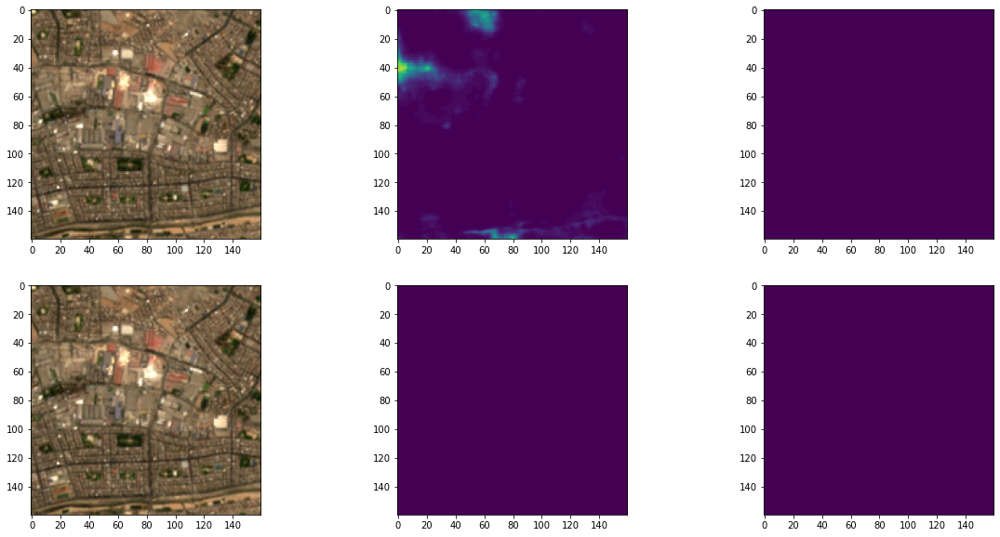

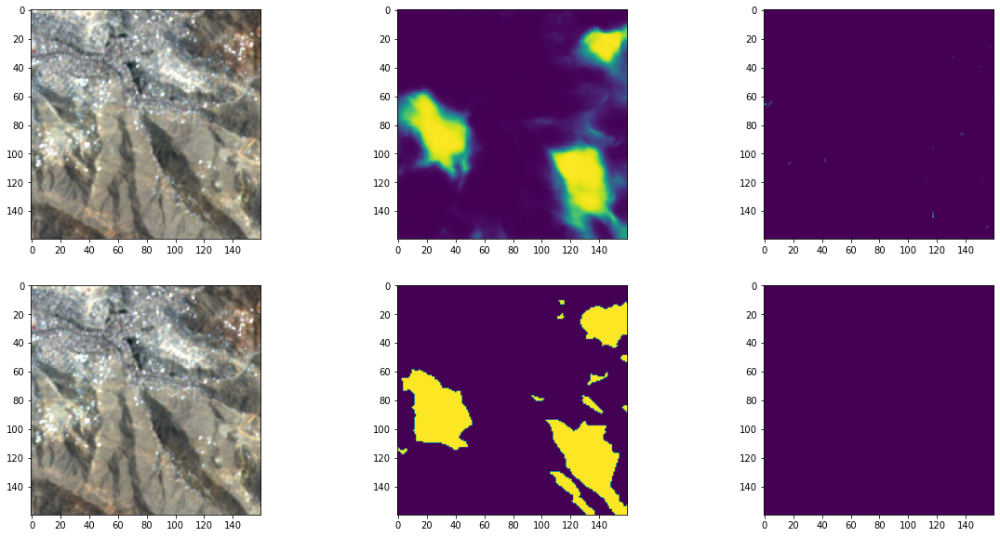

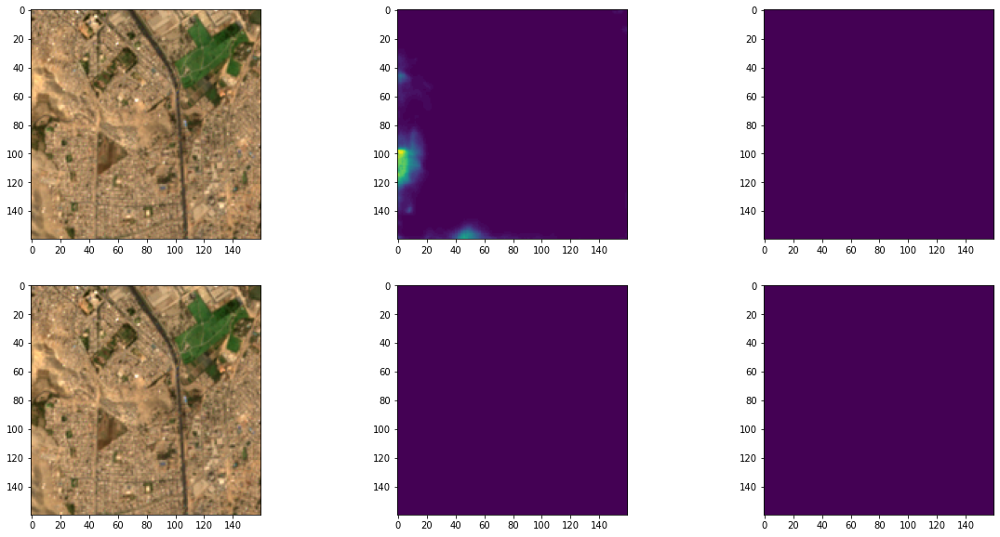

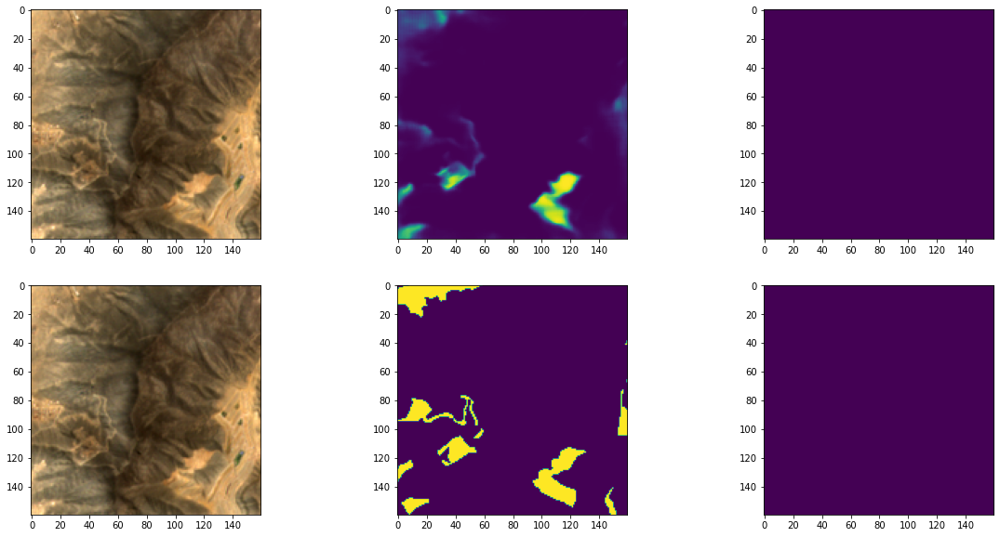

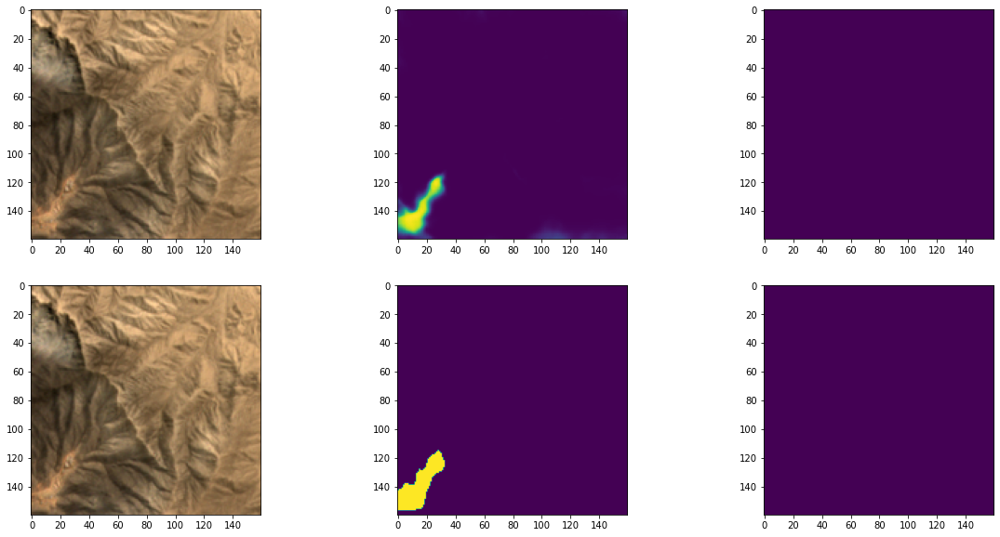

...

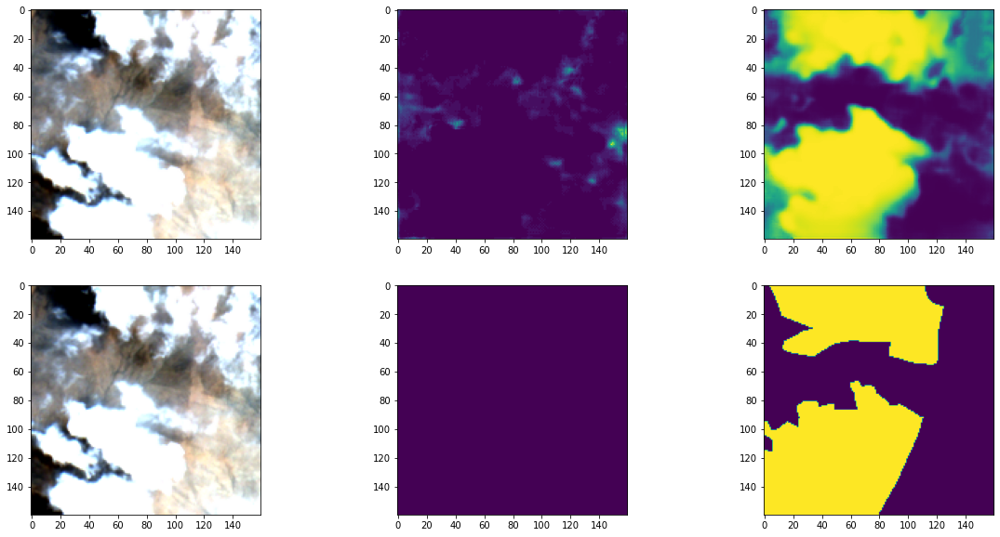

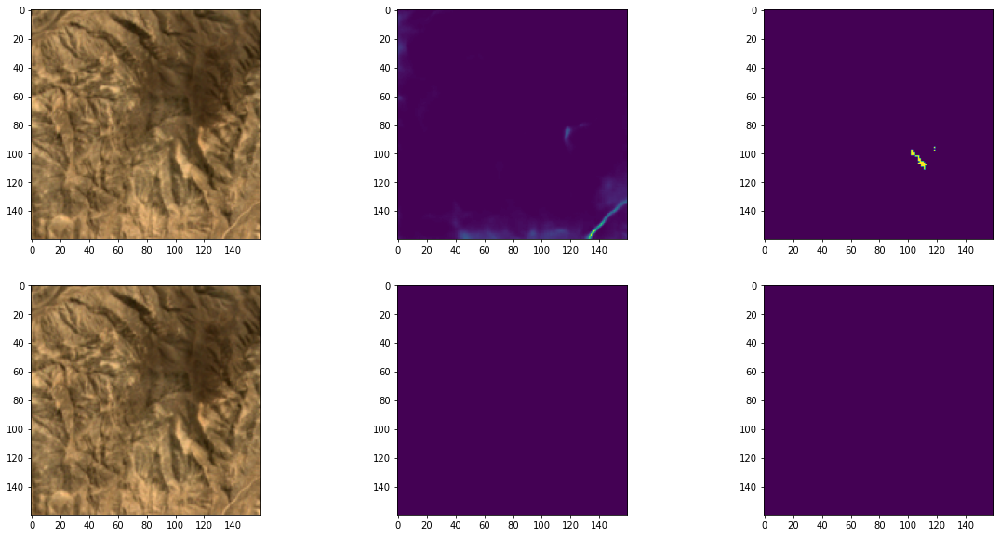

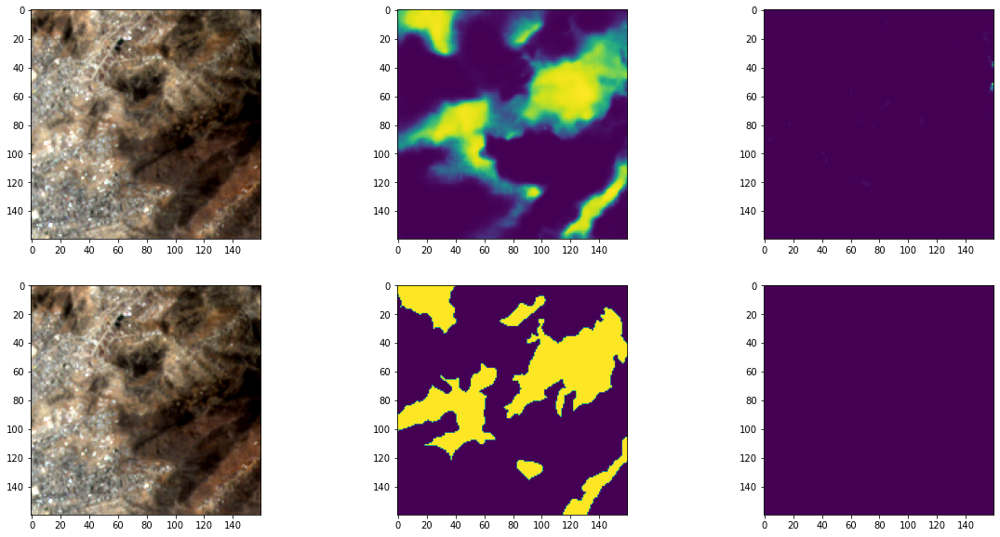

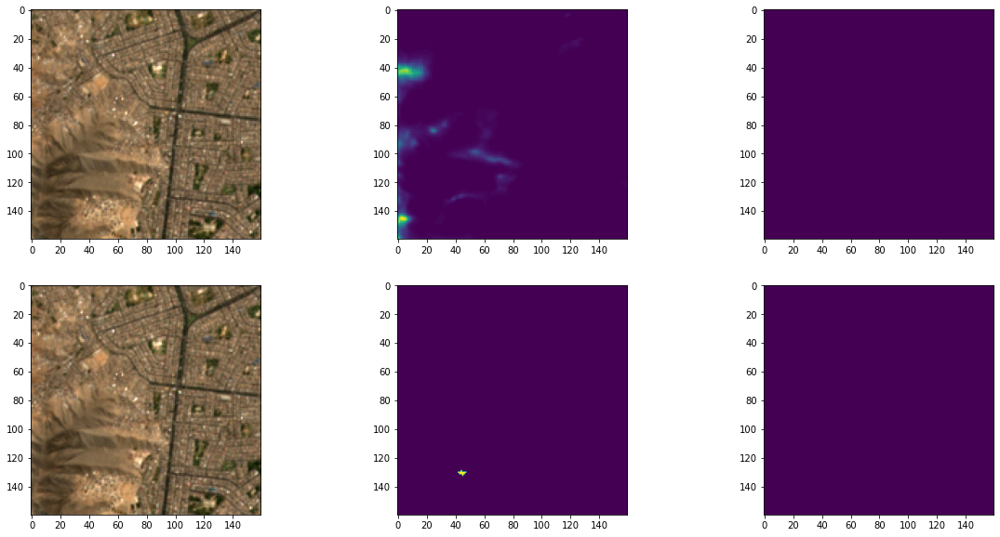

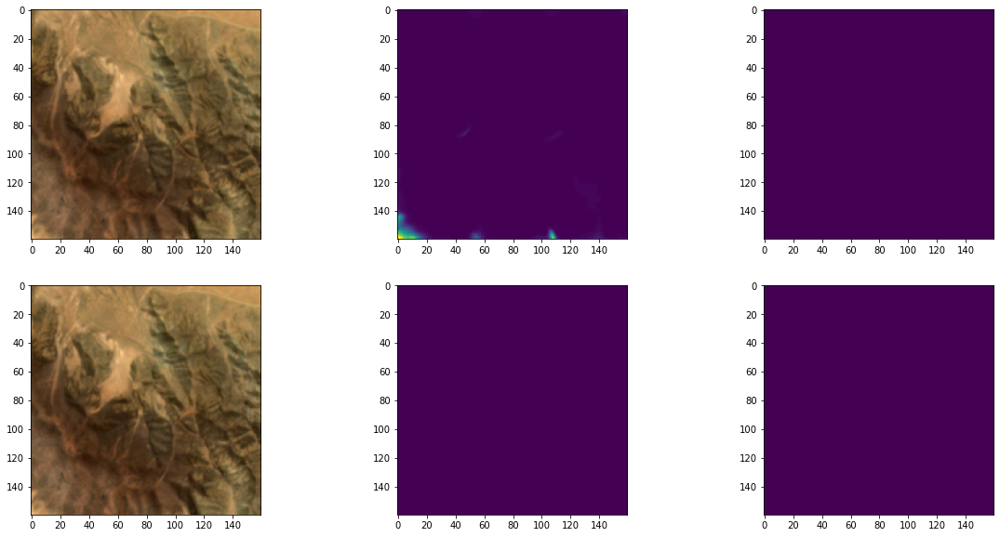

In [23]:
predict_config = PredictConfig(
    images_path=os.path.join(DATA_DIR, 'train', '160_80'),
    results_path=os.path.join(DATA_DIR, 'train', '160_80', 'results', 'v10'),
    batch_size=64,
    model_path=model_path,
    height=160,
    width=160,
    n_channels=3,
    n_classes=2)
plot_evaluate_all(predict_config)

Resultados anteriores..

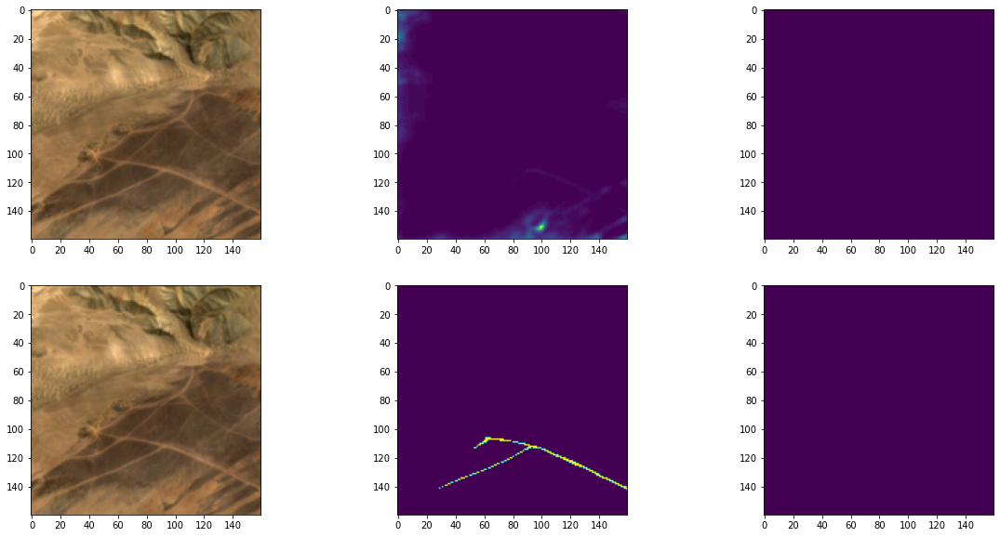

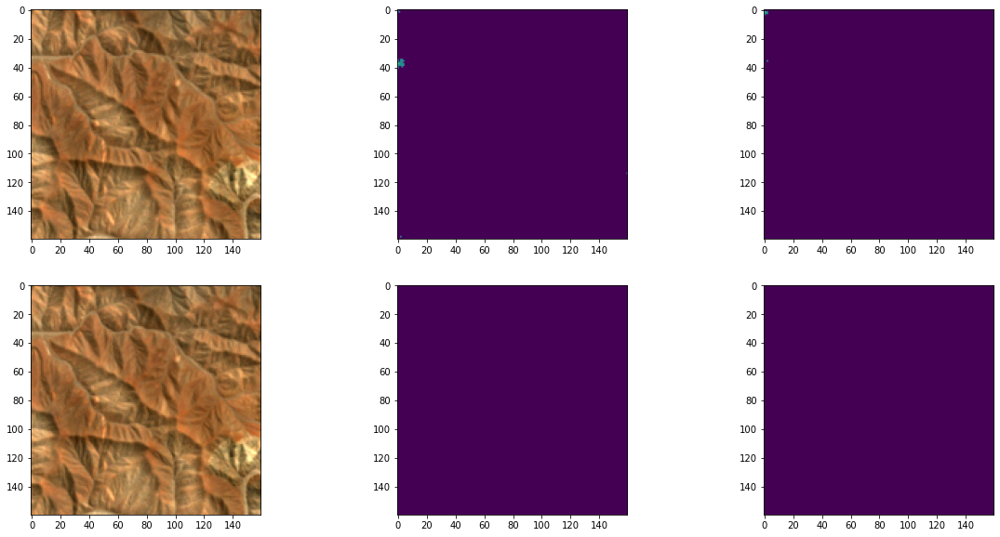

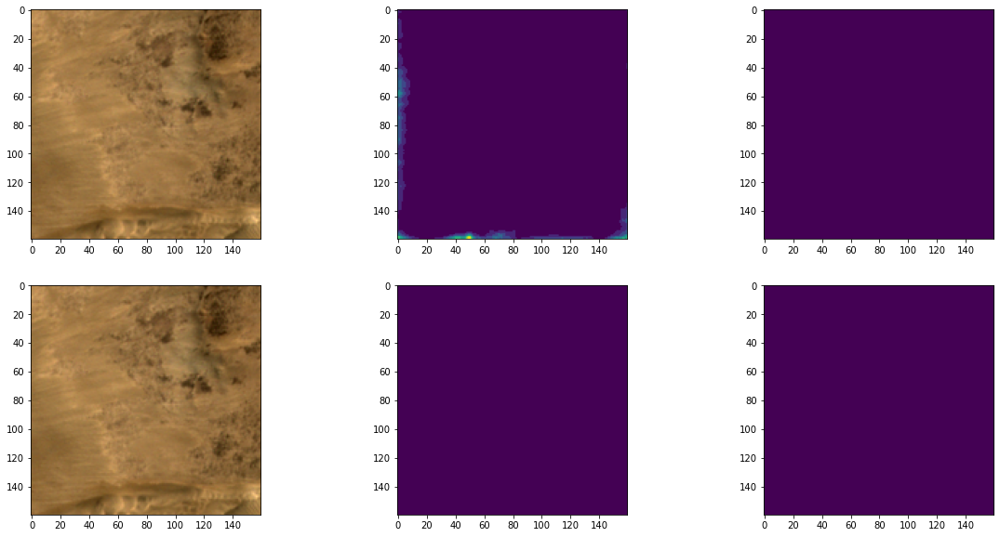

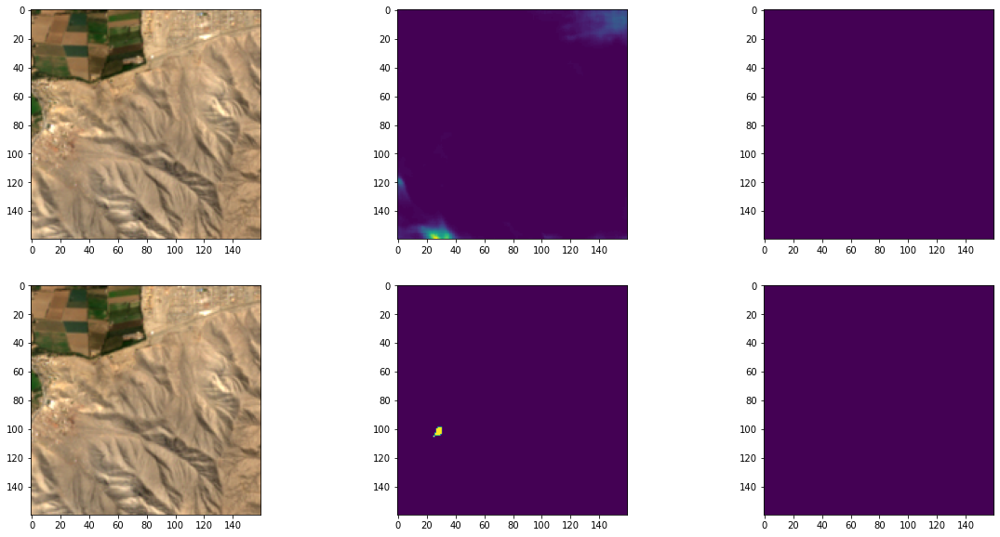

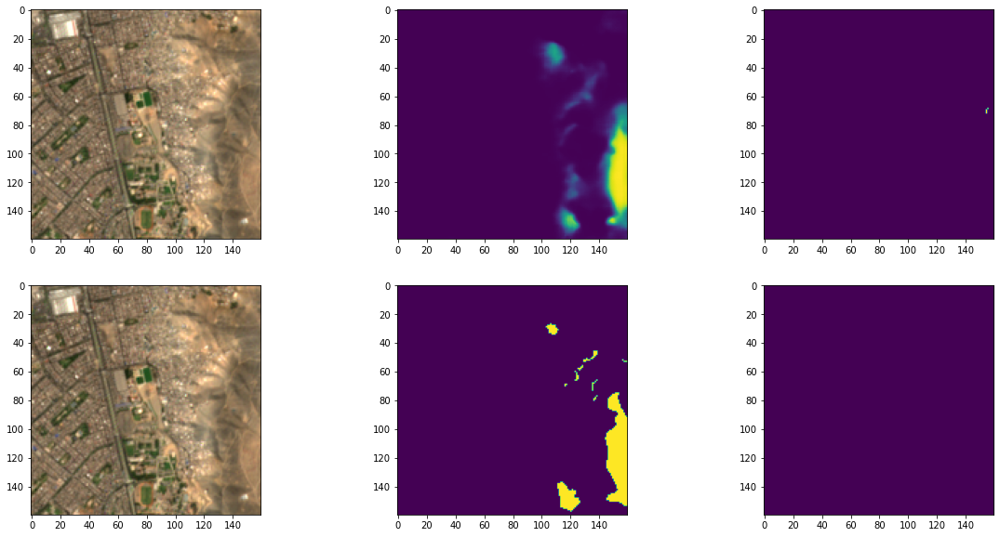

...

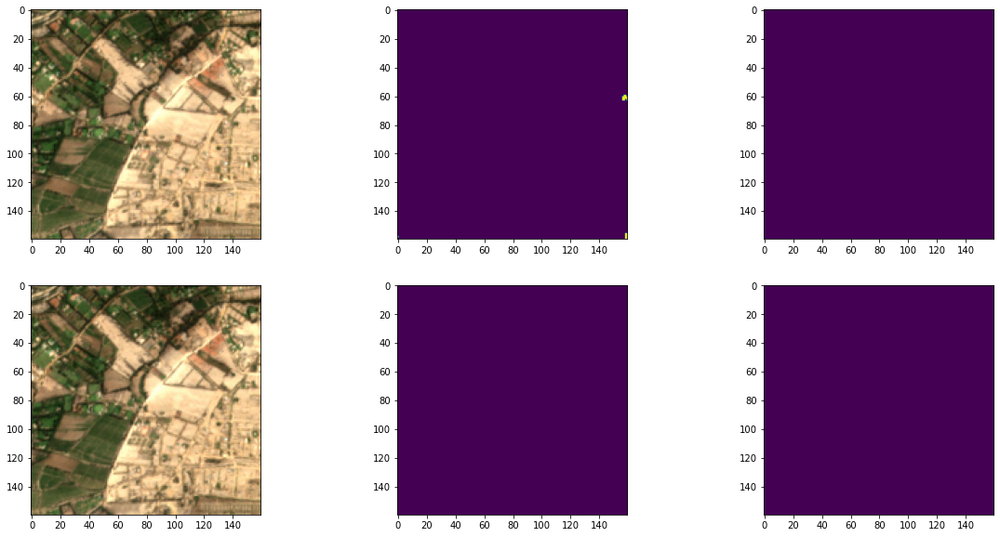

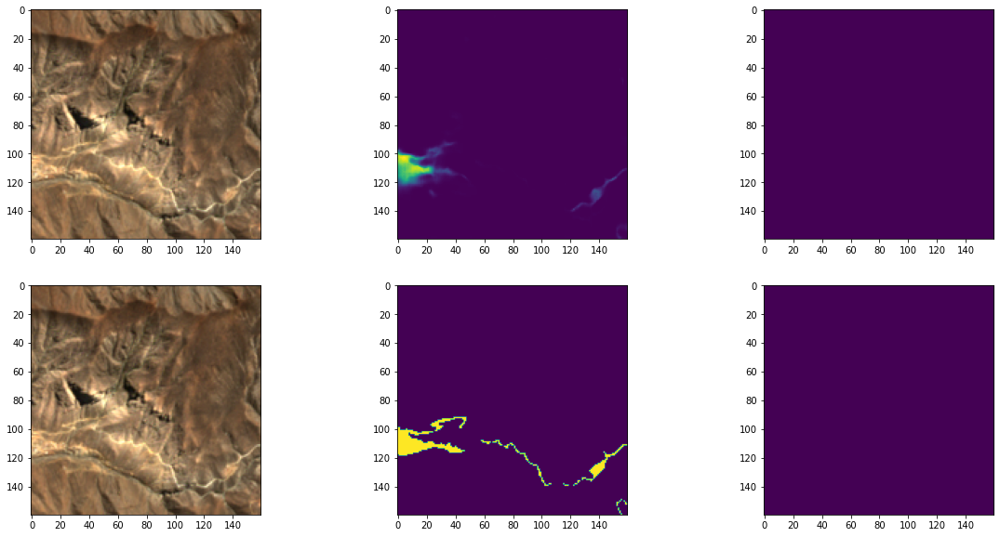

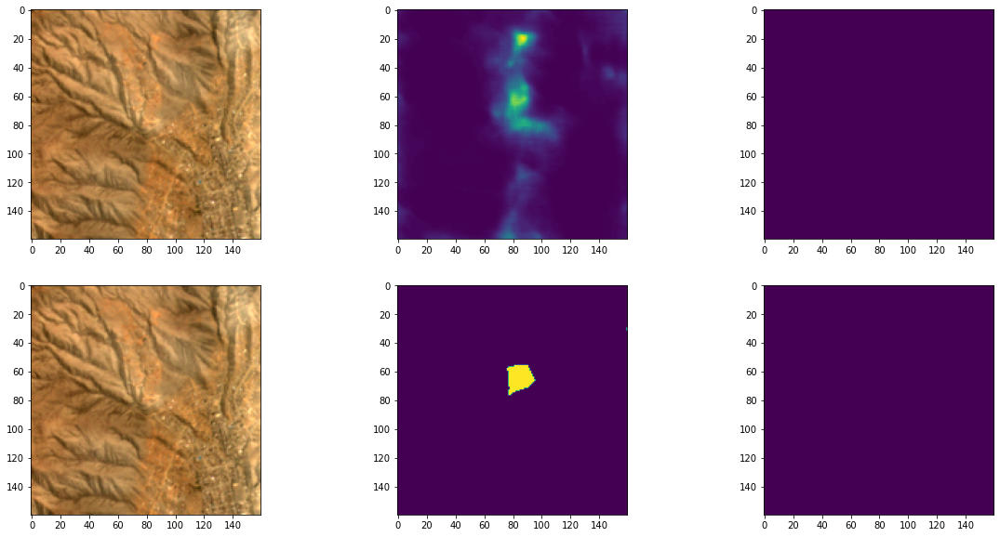

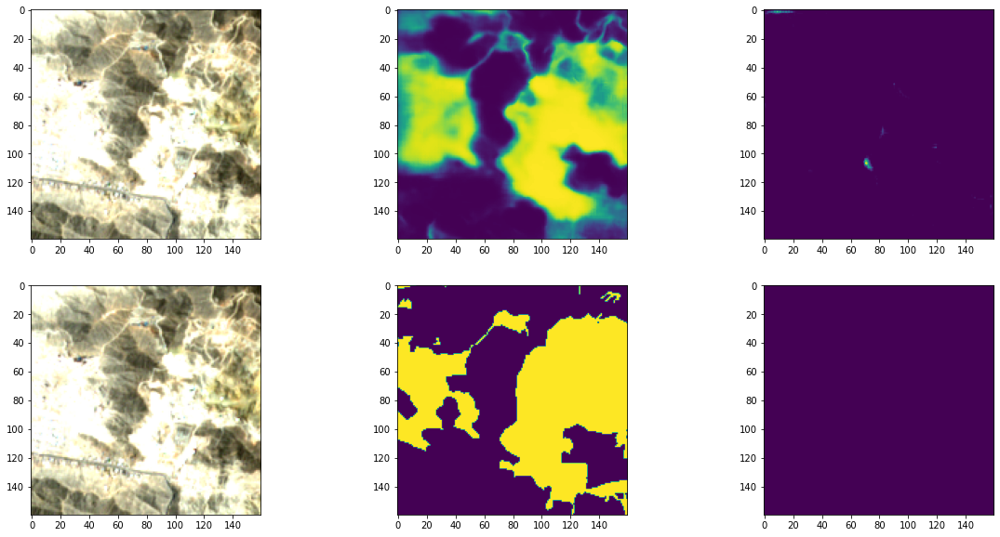

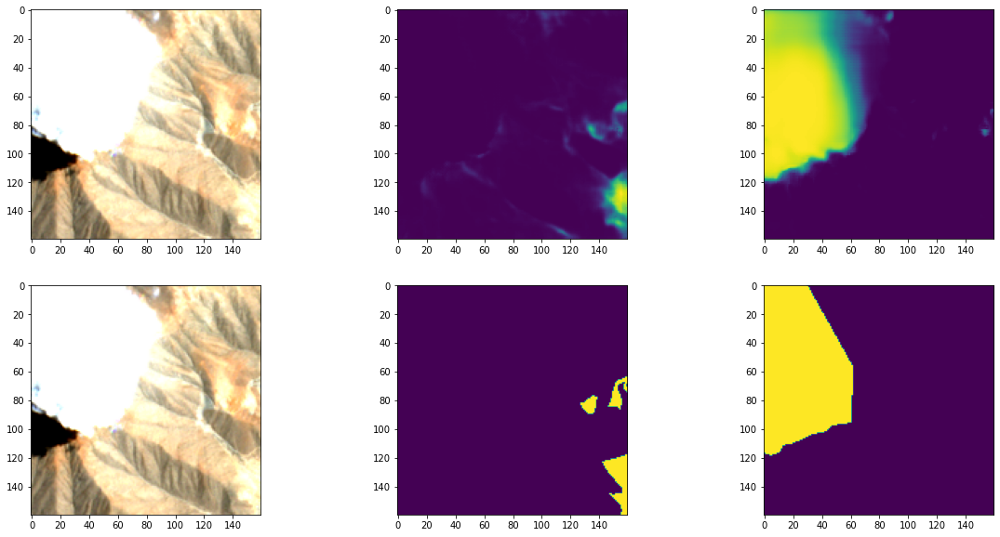

In [38]:
predict_config = PredictConfig(
    images_path=os.path.join(DATA_DIR, 'train', '160_80'),
    results_path=os.path.join(DATA_DIR, 'train', '160_80', 'results', 'v10'),
    batch_size=64,
    model_path=model_path,
    height=160,
    width=160,
    n_channels=3,
    n_classes=2)
plot_evaluate_all(predict_config)

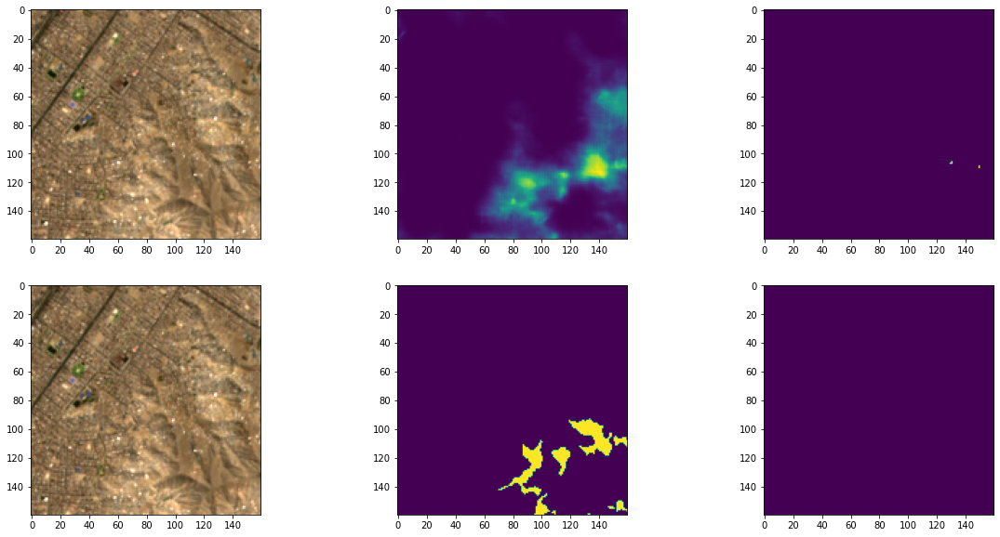

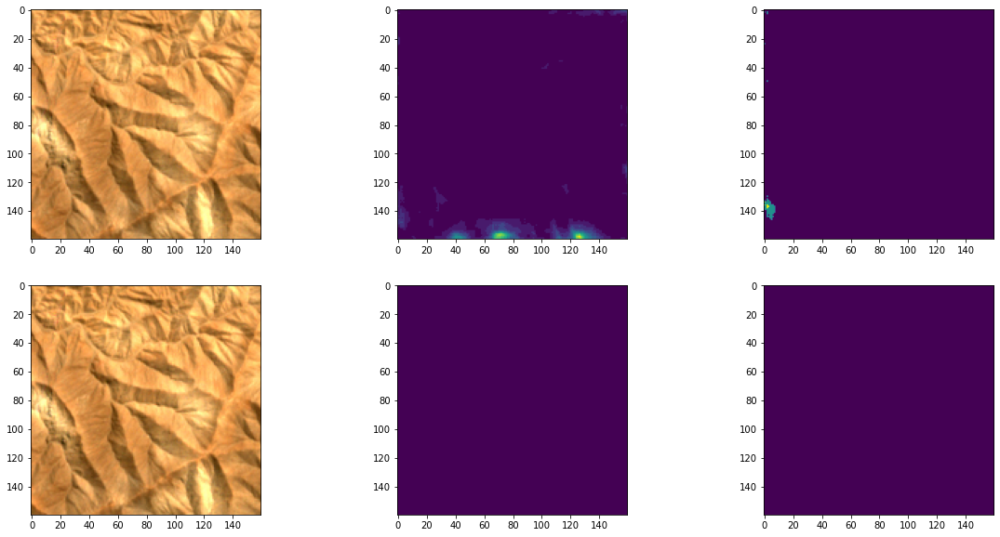

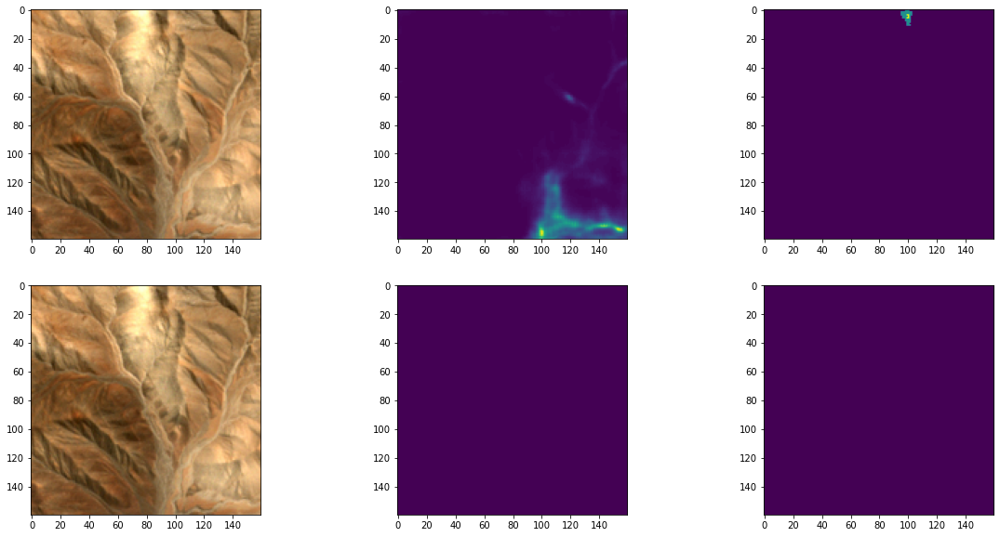

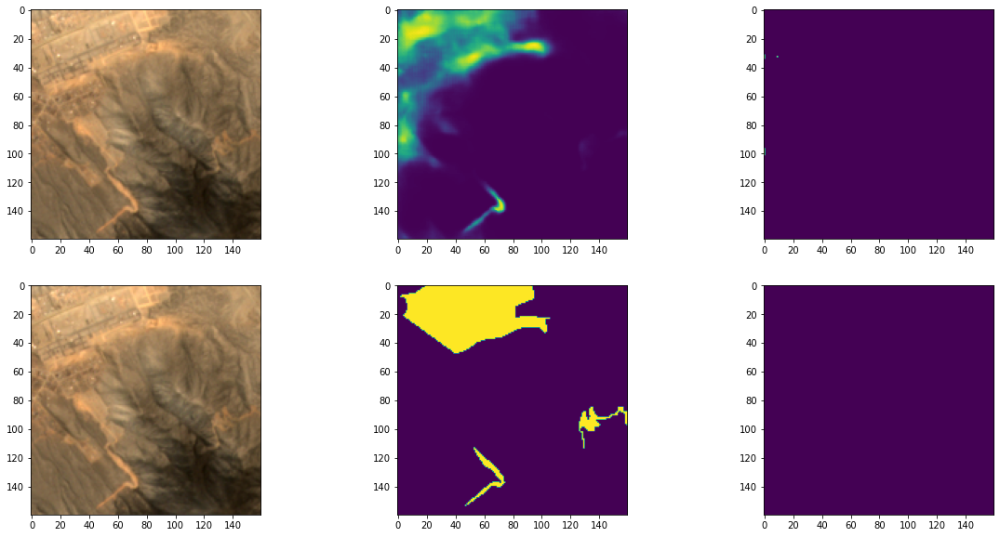

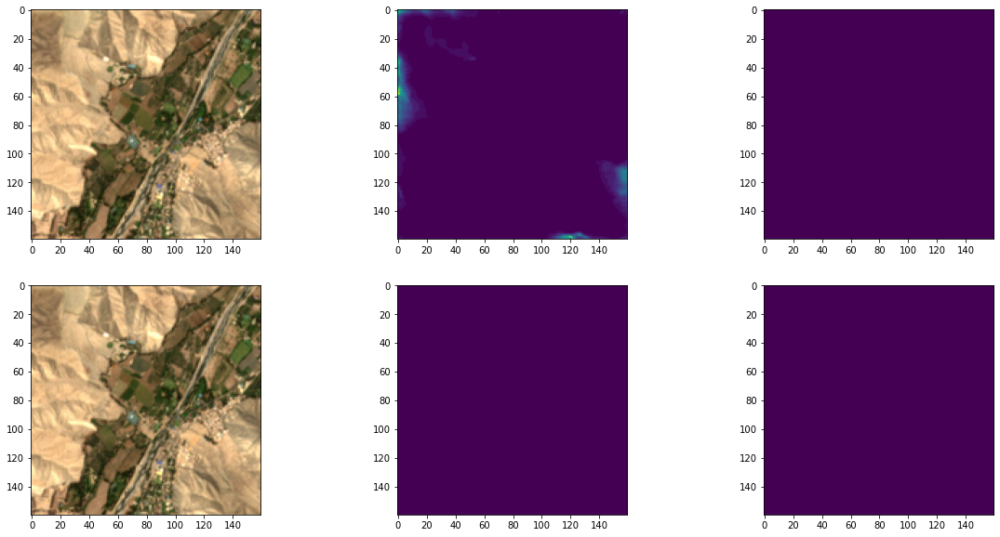

...

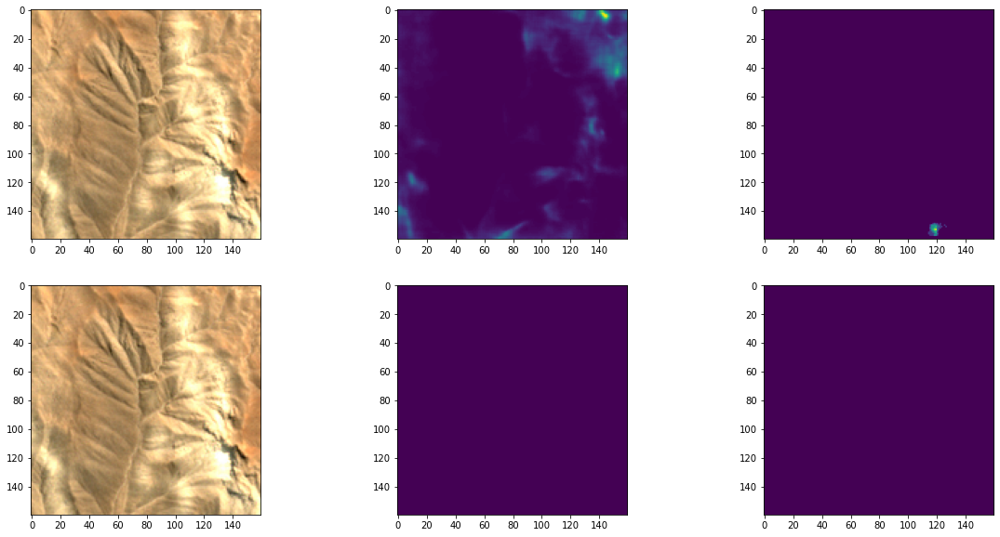

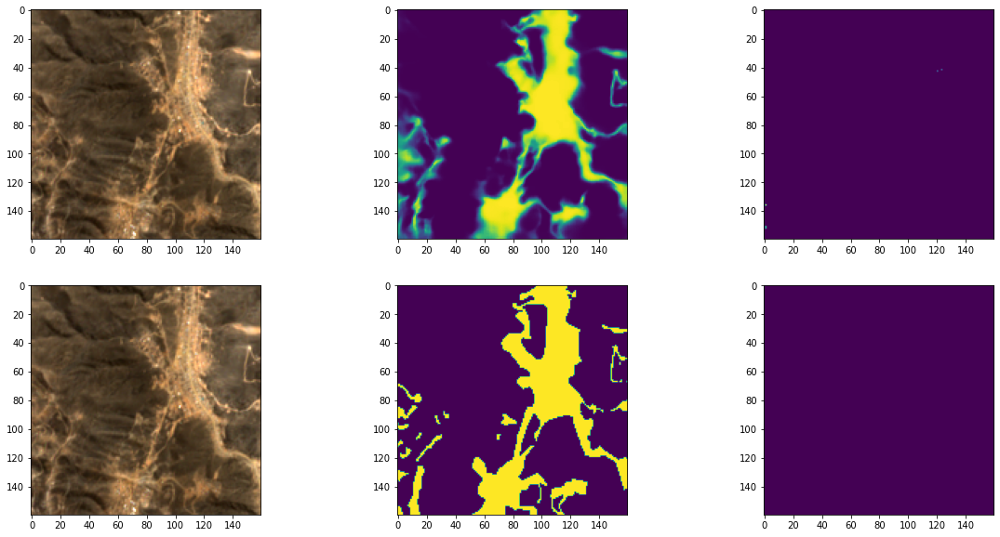

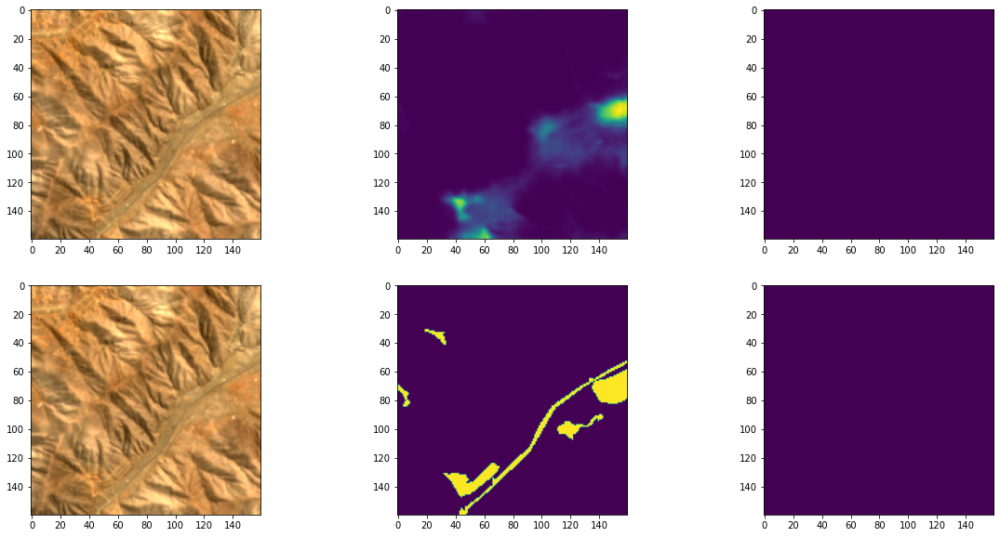

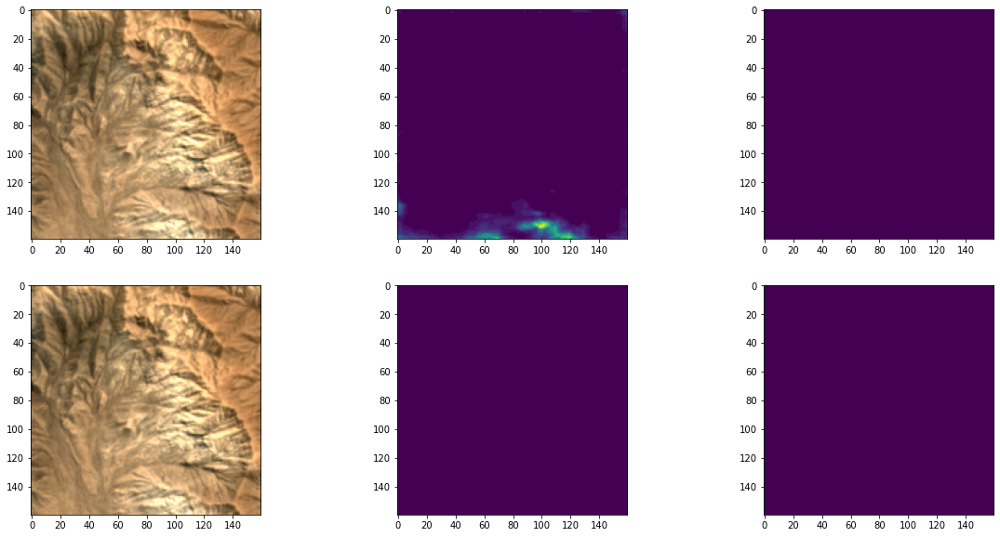

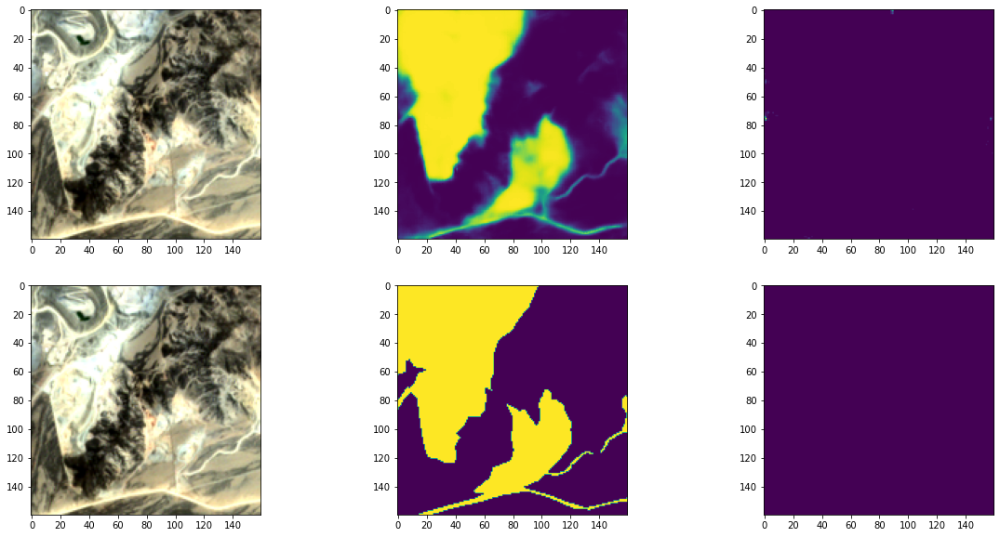

In [39]:
plot_evaluate_all(predict_config)